In [1]:
%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [2]:
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

In [3]:
import numpy as np
from tqdm import tqdm
from pathlib import Path
import openslide
import pandas as pd
import pickle

In [4]:
from fastai.callbacks.csv_logger import CSVLogger

In [5]:
from object_detection_fastai.helper.object_detection_helper import *
from object_detection_fastai.helper.wsi_loader import *
from object_detection_fastai.loss.RetinaNetFocalLoss import RetinaNetFocalLoss
from object_detection_fastai.models.RetinaNet import RetinaNet
from object_detection_fastai.callbacks.callbacks import BBLossMetrics, BBMetrics, PascalVOCMetric, PascalVOCMetricByDistance

In [6]:
slides_train = list(set(['BAL Promyk Spray 4.svs',
                         'BAL AIA Blickfang Luft.svs']))

slides_val = list(set(['BAL 1 Spray 2.svs', 
                         'BAL Booker Spray 3.svs',
                         'BAL Bubi Spray 1.svs', 
                         'BAL cent blue Luft 2.svs']))

labels = ['Mastzellen', "Makrophagen", "Neutrophile", "Eosinophile", "Lymohozyten"]

In [7]:
experiment_name = "Asthma-L0-Screening"

In [8]:
annotations_path = Path("../Statistics/Asthma_Annotations.pkl")
annotations = pd.read_pickle(annotations_path)

annotations = annotations[annotations["class"].isin(labels)]
annotations_train = annotations[annotations["image_name"].isin(slides_train)]
annotations_val = annotations[annotations["image_name"].isin(slides_val)]
annotations_train.head()

,id,image_id,image_name,image_set,class,vector,unique_identifier,user_id,deleted,last_editor
21105,140917,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14371, 'x2': 14435, 'y1': 14738, 'y2': ...",2c2f610e-f4f7-4e05-8236-ffa28418550d,10,False,None
21106,140918,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14066, 'x2': 14152, 'y1': 14692, 'y2': ...",bcf159fc-2a41-4a69-a4cd-9b48da8fc663,10,False,None
21107,140919,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14377, 'x2': 14451, 'y1': 14646, 'y2': ...",f5e247d5-9c38-4e22-9329-56805024cf83,10,False,None
21108,140920,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14304, 'x2': 14384, 'y1': 14600, 'y2': ...",f68910d0-eb8f-4715-ad8d-accd060efff1,10,False,None
21109,140921,226,BAL Promyk Spray 4.svs,14,Makrophagen,"{'x1': 14318, 'x2': 14402, 'y1': 14544, 'y2': ...",013f3fc1-b603-41ce-8357-e446db2c9a14,10,False,None


In [9]:
annotations["width"] = [vector["x2"] - vector["x1"] for vector in annotations["vector"]]
annotations["height"] = [vector["y2"] - vector["y1"] for vector in annotations["vector"]]
annotations["scale"] = annotations["width"] / annotations["height"]

<AxesSubplot:xlabel='width', ylabel='height'>

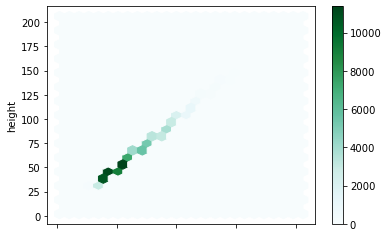

In [10]:
annotations.plot.hexbin(x='width', y='height', gridsize=25) #C='scale', 

In [11]:
slides_path = Path("../Slides")
files = {slide.name: slide for slide in slides_path.rglob("*.svs") if slide.name in slides_train + slides_val}
files

{'BAL 1 Spray 2.svs': WindowsPath('../Slides/BAL 1 Spray 2.svs'),
 'BAL AIA Blickfang Luft.svs': WindowsPath('../Slides/BAL AIA Blickfang Luft.svs'),
 'BAL Booker Spray 3.svs': WindowsPath('../Slides/BAL Booker Spray 3.svs'),
 'BAL Bubi Spray 1.svs': WindowsPath('../Slides/BAL Bubi Spray 1.svs'),
 'BAL cent blue Luft 2.svs': WindowsPath('../Slides/BAL cent blue Luft 2.svs'),
 'BAL Promyk Spray 4.svs': WindowsPath('../Slides/BAL Promyk Spray 4.svs')}

In [12]:
with open('../Statistics/Screening.pickle', 'rb') as handle:
    screening_modes = pickle.load(handle)

In [13]:
def filterAnnotations(image_name, xmin, ymin, screening_modes, patch_x:int = 1024, patch_y:int = 1024):
    
    screening = screening_modes[image_name]
    tiles = screening["screening_tiles"]  
    
    xmin, ymin = max(1, int(xmin - patch_x / 2)), max(1, int(ymin - patch_y / 2))
    
    x_step = int(np.ceil(xmin / screening["x_resolution"]))
    y_step = int(np.ceil(ymin / screening["y_resolution"]))
    
    return tiles[str((y_step * screening["x_steps"]) + x_step)]['Screened']

In [14]:
annotations_train["border"] = annotations_train.apply(lambda x: filterAnnotations(x["image_name"], x["vector"]["x1"], x["vector"]["y1"], screening_modes), axis=1)
annotations_val["border"] = annotations_val.apply(lambda x: filterAnnotations(x["image_name"], x["vector"]["x1"], x["vector"]["y1"], screening_modes), axis=1)
annotations_val.head()

d:\anaconda3\envs\eiph_wsi\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.
d:\anaconda3\envs\eiph_wsi\lib\site-packages\ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  


,id,image_id,image_name,image_set,class,vector,unique_identifier,user_id,deleted,last_editor,border
0,172441,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13612, 'x2': 13666, 'y1': 12371, 'y2': ...",a268b46f-e13f-480e-b96d-c7900790ad5f,10,False,None,False
1,172442,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13562, 'x2': 13618, 'y1': 12437, 'y2': ...",e8d67efd-0baf-4f78-ad73-b8f77422b826,10,False,None,False
2,172443,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13482, 'x2': 13546, 'y1': 12458, 'y2': ...",55aa3d51-7f30-43a0-83ef-d9acc74d9a21,10,False,None,False
3,172444,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13471, 'x2': 13533, 'y1': 12281, 'y2': ...",8f259e8f-119b-44de-8a90-2c53e7ee0e60,10,False,None,False
4,172446,221,BAL 1 Spray 2.svs,14,Makrophagen,"{'x1': 13591, 'x2': 13673, 'y1': 12204, 'y2': ...",052b3f5a-f6f6-4b0d-a134-9f4797601dc4,10,False,None,False


In [15]:
class SlideContainerWithScreening(SlideContainer):

    def get_new_train_coordinates(self):
        # use passed sampling method
        if callable(self.sample_func):
            return self.sample_func(self.y, **{"classes": self.classes, "size": self.shape,
                                               "level_dimensions": self.slide.level_dimensions,
                                               "level": self.level})

        # use default sampling method
        width, height = self.slide.level_dimensions[self.level]
        if len(self.y[0]) == 0:
            return randint(0, width - self.shape[0]), randint(0, height - self.shape[1])
        else:
            # use default sampling method
            class_id = np.random.choice( self.classes, 1)[0]
            ids = (np.array(self.y[1]) == class_id) & (np.array(self.y[2]) == True)
            #  if you can´t fond any ignore screened area
            if np.count_nonzero(ids) == 0:
                ids = (np.array(self.y[1]) == class_id)
            xmin, ymin, _, _ = np.array( self.y[0])[ids][randint(0, np.count_nonzero(ids) - 1)]

            xmin, ymin = max(1, int(xmin - self.shape[0] / 2)), max(1, int(ymin - self.shape[1] / 2))
            xmin, ymin = min(xmin, width - self.shape[0]), min(ymin, height - self.shape[1])

            return xmin, ymin

In [16]:
size = 1024 
level = 0
bs = 16
train_images = 500
val_images = 500

In [17]:
train_files = []
val_files = []

In [18]:
for image_name in annotations_train["image_name"].unique():
    
    annotations = annotations_train[annotations_train["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    borders = list(annotations["border"])
    
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)
            borders.append(True)

    train_files.append(SlideContainerWithScreening(slide_path, y=[bboxes, labels, borders],  level=level, width=size, height=size))
    
for image_name in annotations_val["image_name"].unique():
    
    annotations = annotations_val[annotations_val["image_name"] == image_name]
    annotations = annotations[annotations["deleted"] == False]
    
    slide_path = files[image_name]
    labels =  list(annotations["class"])
    borders = list(annotations["border"])
    
    bboxes = [[vector["x1"], vector["y1"], vector["x2"], vector["y2"]] for vector in annotations["vector"]]
    
    for label in labels:
        if label not in set(labels):
            bboxes.append([0,0,0,0])
            labels.append(label)
            borders.append(True)

    val_files.append(SlideContainerWithScreening(slide_path, y=[bboxes, labels, borders],  level=level, width=size, height=size))

train_files = list(np.random.choice(train_files, train_images))
valid_files = list(np.random.choice(val_files, val_images))

In [19]:
tfms = get_transforms(do_flip=True,
                      flip_vert=True,
                      #max_rotate=90,
                      #max_lighting=0.0,
                      #max_zoom=1.,
                      #max_warp=0.0,
                      #p_affine=0.5,
                      #p_lighting=0.0,
                      #xtra_tfms=xtra_tfms,
                     )

In [20]:
def get_y_func(x):
    return x.y

In [21]:
train =  ObjectItemListSlide(train_files, path=slides_path)
valid = ObjectItemListSlide(valid_files, path=slides_path)
item_list = ItemLists(slides_path, train, valid)
lls = item_list.label_from_func(get_y_func, label_cls=SlideObjectCategoryList) #
lls = lls.transform(tfms, tfm_y=True, size=size)
data = lls.databunch(bs=bs, collate_fn=bb_pad_collate, num_workers=0).normalize()

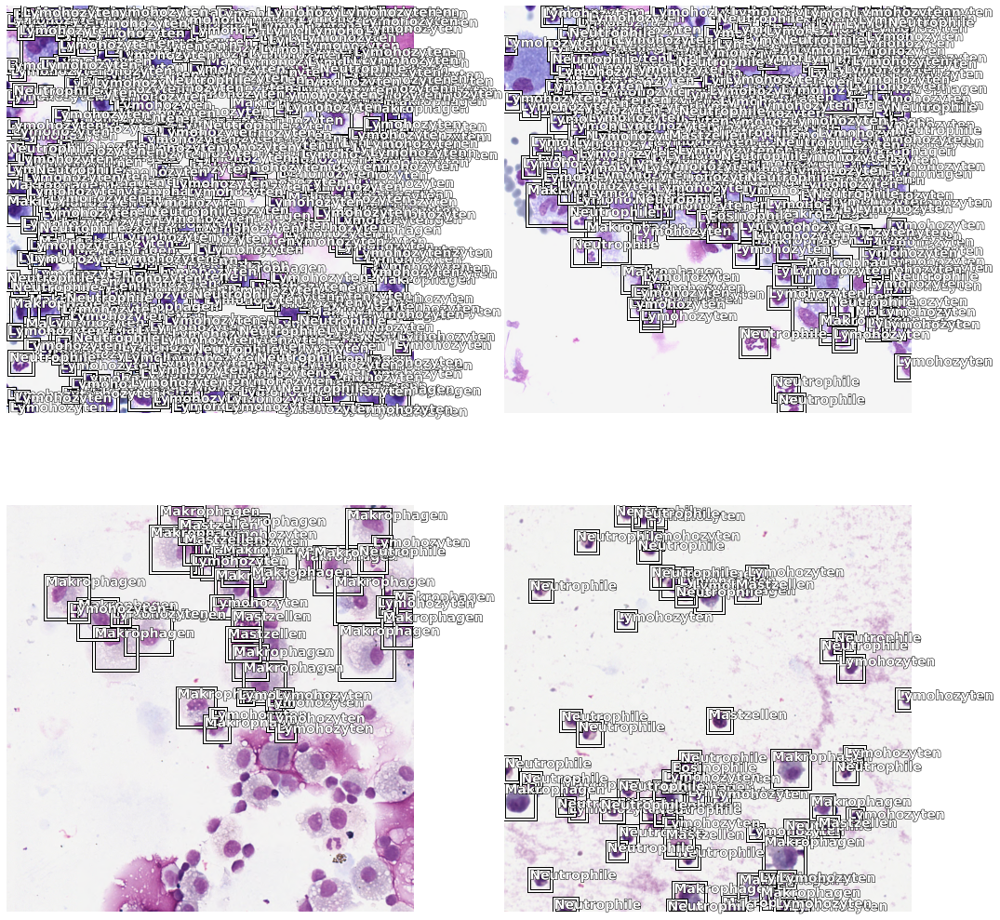

In [22]:
data.show_batch(rows=2, ds_type=DatasetType.Valid, figsize=(15,15))

In [23]:
scales = [.6, .7, .8, .9, 1, 1.1]
anchors = create_anchors(sizes=[(64, 64), (32,32)], ratios=[1], scales=scales)

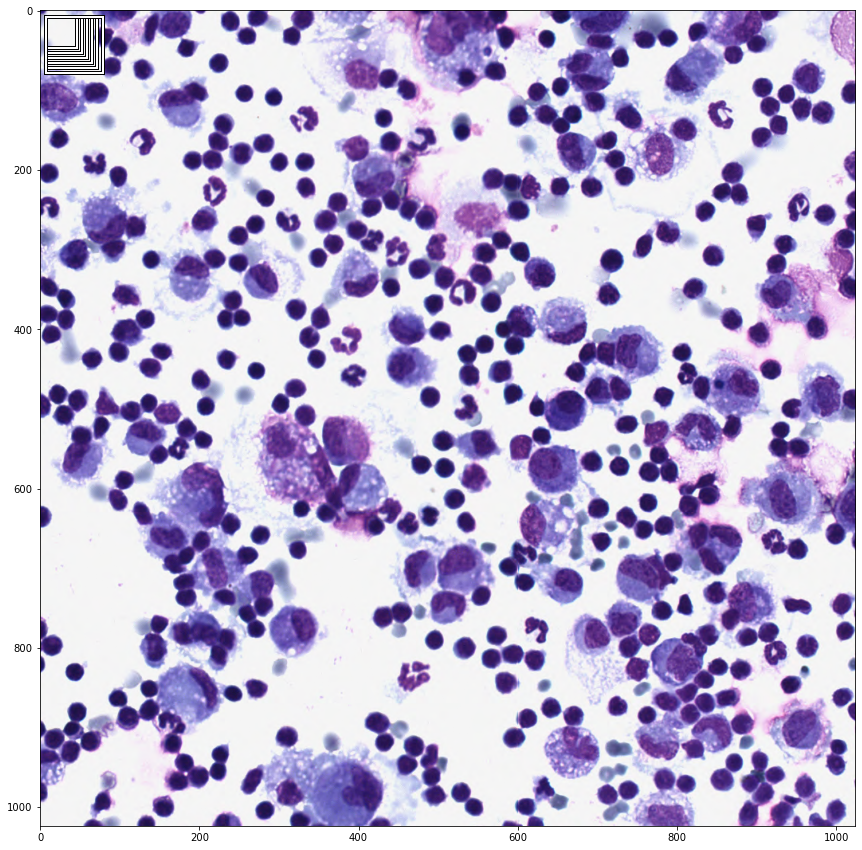

In [24]:
fig,ax = plt.subplots(figsize=(15,15))
ax.imshow(image2np(data.valid_ds[0][0].data))

for i, bbox in enumerate(anchors[:len(scales)]):
    bb = bbox.numpy()
    x = (bb[0] + 1) * size / 2 
    y = (bb[1] + 1) * size / 2 
    w = bb[2] * size / 2
    h = bb[3] * size / 2
    
    rect = [x,y,w,h]
    draw_rect(ax,rect)

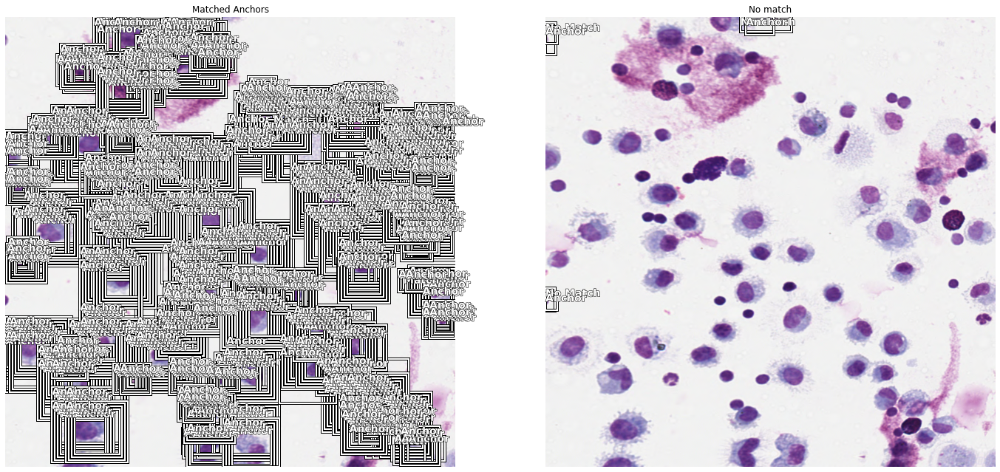

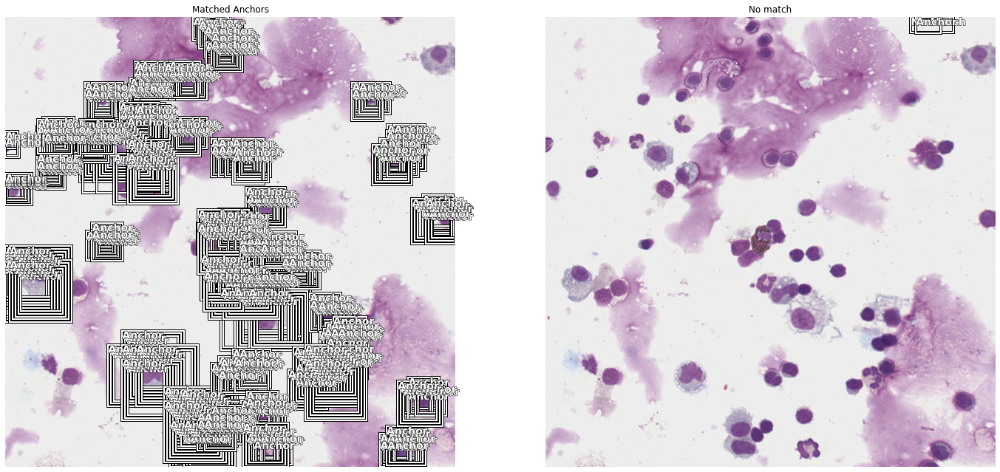

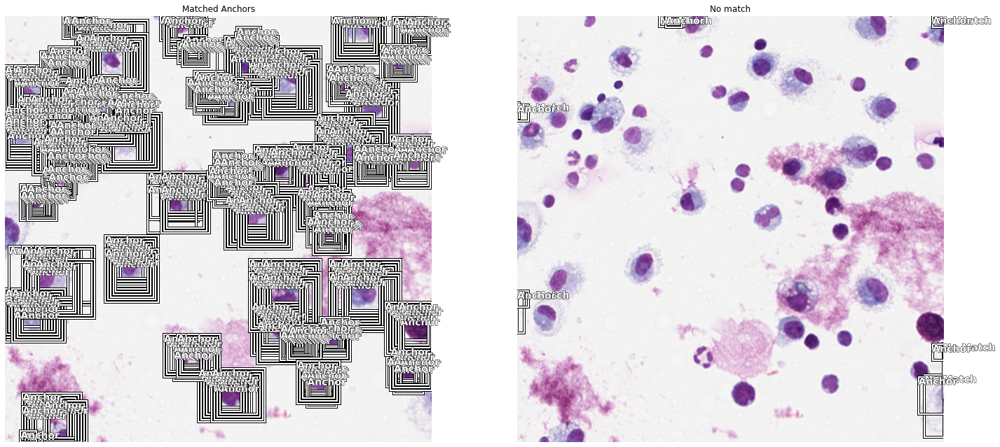

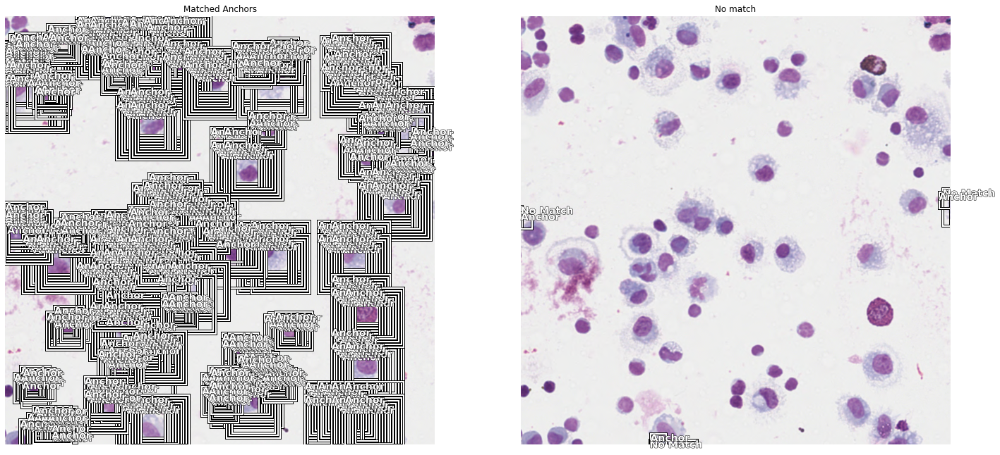

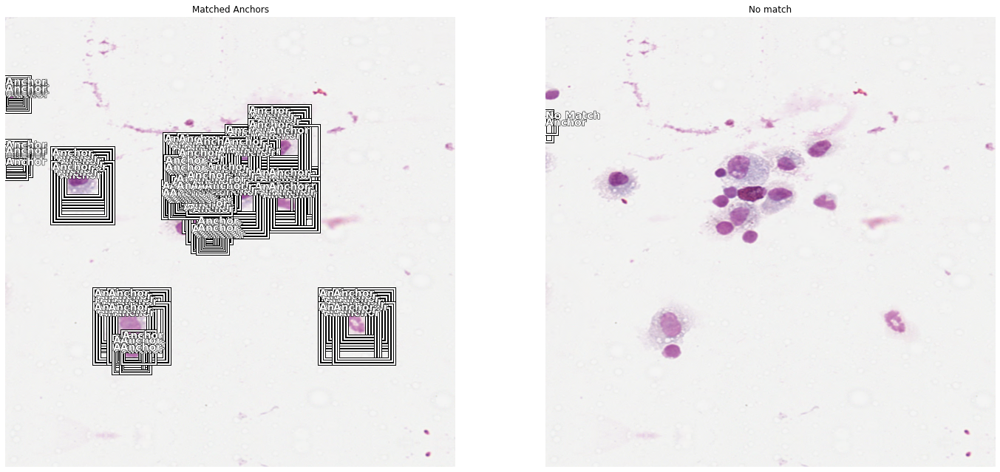

...

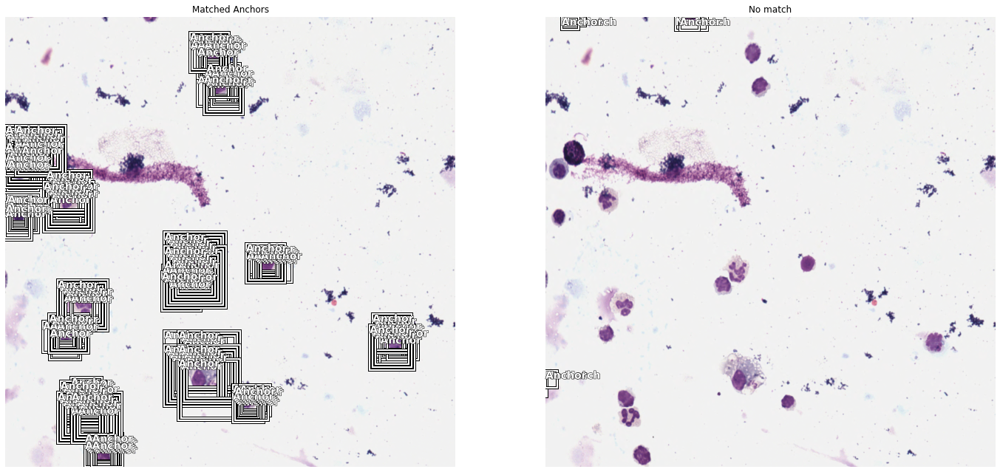

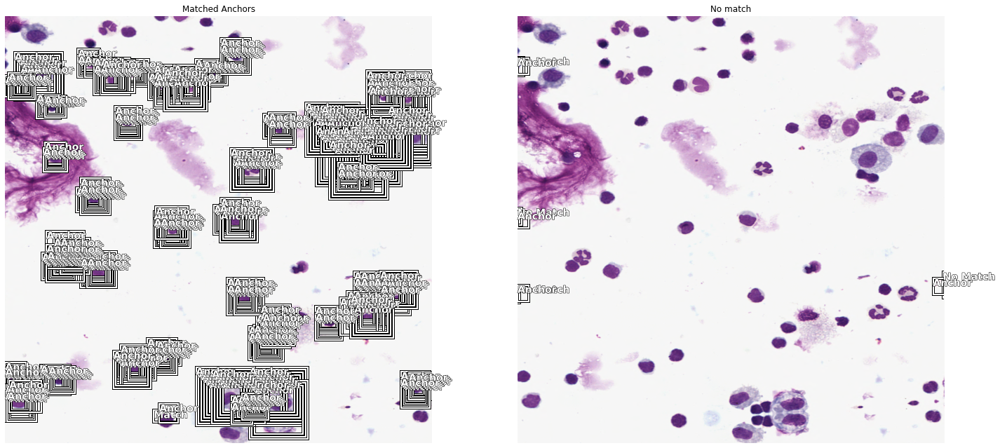

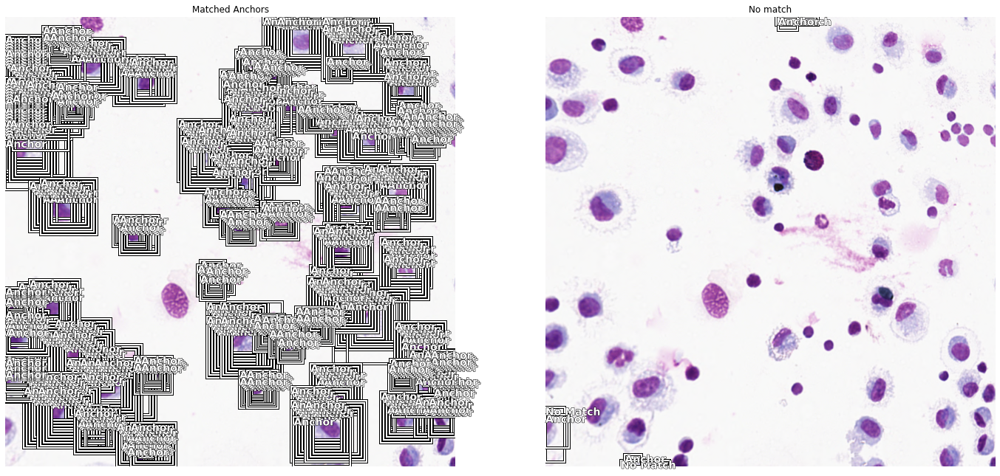

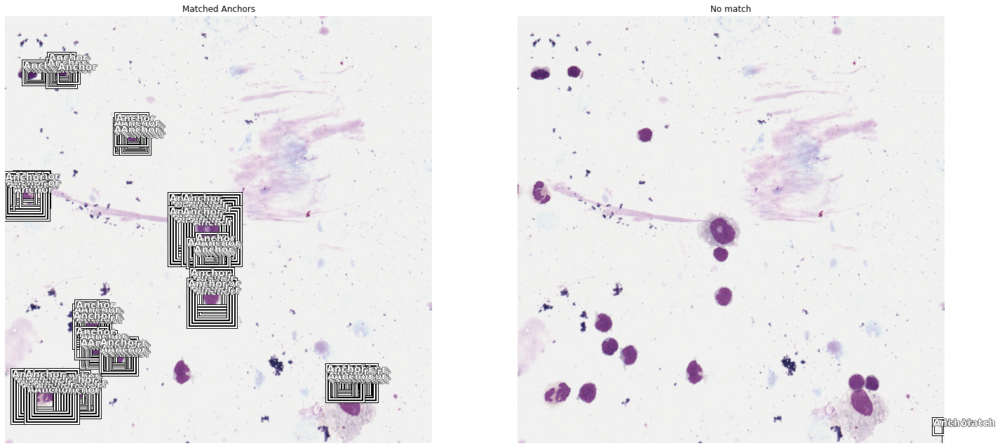

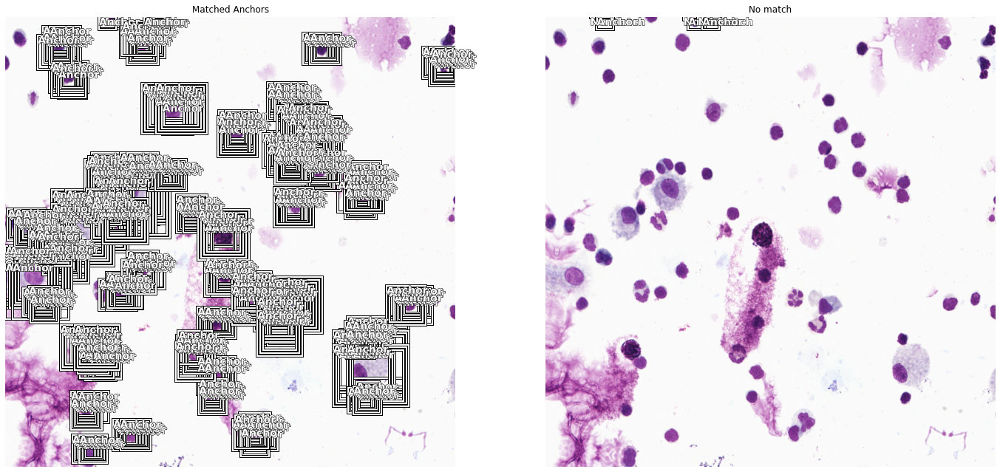

In [25]:
all_boxes, all_labels = show_anchors_on_images(data, anchors, figsize=(24, 24))

In [26]:
crit = RetinaNetFocalLoss(anchors)

encoder = create_body(models.resnet18, True, -2)
model = RetinaNet(encoder, n_classes=data.train_ds.c, n_anchors=len(scales), sizes=[64, 32], chs=128, final_bias=-4., n_conv=2)

In [27]:
data.train_ds.y.classes[1:]

['Eosinophile', 'Lymohozyten', 'Makrophagen', 'Mastzellen', 'Neutrophile']

In [28]:
voc = PascalVOCMetricByDistance(anchors, size, [str(i) for i in data.train_ds.y.classes[1:]], radius=40)
learn = Learner(data, model, loss_func=crit, callback_fns=[BBMetrics], #BBMetrics, ShowGraph
                metrics=[voc])

In [29]:
learn.split([model.encoder[6], model.c5top5])
learn.freeze_to(-2)

In [30]:
learn.fit_one_cycle(3, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,1.321444,0.861545,0.241335,0.310354,0.551191,0.150407,0.413166,0.404600,0.035689,0.202813,15:10
1,0.725500,0.556176,0.408458,0.232967,0.323208,0.054187,0.454273,0.686743,0.344341,0.502748,13:32
2,0.498314,0.513275,0.469991,0.198779,0.314496,0.333434,0.490082,0.676668,0.335450,0.514323,13:53


In [31]:
learn.unfreeze()
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.311781,0.609570,0.480488,0.267508,0.342061,0.326467,0.493848,0.639742,0.343589,0.598793,13:25
1,0.298184,0.571906,0.530382,0.209050,0.362856,0.518949,0.477466,0.608749,0.371600,0.675147,13:26
2,0.321409,0.565722,0.524907,0.214080,0.351642,0.524958,0.536360,0.699114,0.421118,0.442983,14:32
3,0.288190,0.455351,0.578339,0.162326,0.293025,0.772009,0.566511,0.703725,0.350766,0.498686,14:44
4,0.258306,0.444673,0.610808,0.161237,0.283436,0.597603,0.502683,0.736122,0.600251,0.617384,13:23
5,0.231943,0.395798,0.588155,0.139281,0.256518,0.639163,0.515850,0.729443,0.518269,0.538048,13:33
6,0.214721,0.399909,0.568496,0.143407,0.256502,0.545136,0.553951,0.698163,0.558335,0.486895,14:03
7,0.198110,0.369695,0.640406,0.140924,0.228771,0.673631,0.544933,0.722845,0.617073,0.643547,13:25
8,0.185906,0.334335,0.641270,0.125843,0.208492,0.655251,0.550819,0.724042,0.600057,0.676180,8:35:00
9,0.176829,0.335805,0.648427,0.120302,0.215503,0.709614,0.542256,0.711090,0.616675,0.662499,14:01


In [32]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.166161,0.332223,0.661665,0.124778,0.207445,0.741915,0.541449,0.724548,0.616957,0.683454,13:44
1,0.178917,0.587032,0.629114,0.142619,0.444413,0.659059,0.573970,0.716722,0.559142,0.636677,14:57
2,0.206717,0.425450,0.598437,0.147656,0.277795,0.534537,0.467901,0.715164,0.616262,0.658322,12:12
3,0.206019,0.380874,0.643083,0.124294,0.256580,0.771121,0.490139,0.711751,0.675686,0.566720,12:52
4,0.201315,0.535118,0.660239,0.240950,0.294169,0.749862,0.443514,0.721540,0.615772,0.770508,12:25
5,0.190167,0.495502,0.614919,0.230809,0.264693,0.561851,0.485432,0.692627,0.676730,0.657953,12:19
6,0.180663,0.328533,0.630297,0.115353,0.213180,0.707371,0.544076,0.747997,0.558533,0.593507,12:50
7,0.167024,0.321605,0.642306,0.116861,0.204744,0.697767,0.535714,0.700767,0.591275,0.686004,13:02
8,0.157556,0.294259,0.641037,0.101324,0.192935,0.688929,0.531818,0.713958,0.591326,0.679155,12:28
9,0.149164,0.297624,0.648370,0.104344,0.193280,0.687632,0.549601,0.695208,0.628105,0.681304,12:56


In [33]:
learn.fit_one_cycle(10, 1e-3)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.142873,0.354276,0.642595,0.128799,0.225478,0.698505,0.550141,0.679356,0.621297,0.663676,12:57
1,0.147808,0.348304,0.596899,0.104562,0.243742,0.728981,0.524244,0.649233,0.354779,0.727259,12:20
2,0.176672,0.412461,0.497513,0.129371,0.283090,0.126657,0.562707,0.649764,0.576581,0.571854,12:57
3,0.189757,0.399379,0.606195,0.142481,0.256898,0.490776,0.566411,0.747055,0.604069,0.622663,13:50
4,0.185251,0.320499,0.556433,0.098895,0.221605,0.358400,0.483840,0.695478,0.599126,0.645322,13:01
5,0.178153,0.340607,0.608941,0.117916,0.222691,0.628339,0.503053,0.753441,0.592544,0.567330,13:30
6,0.167042,0.289813,0.657003,0.103243,0.186569,0.762403,0.514353,0.743410,0.560285,0.704565,12:28
7,0.155461,0.309923,0.652631,0.112489,0.197434,0.707378,0.539246,0.741001,0.604876,0.670655,12:46
8,0.145224,0.321741,0.629422,0.109424,0.212317,0.621588,0.544718,0.722715,0.609660,0.648430,12:47
9,0.137977,0.291627,0.645508,0.097260,0.194367,0.674726,0.546596,0.719214,0.620138,0.666866,13:01


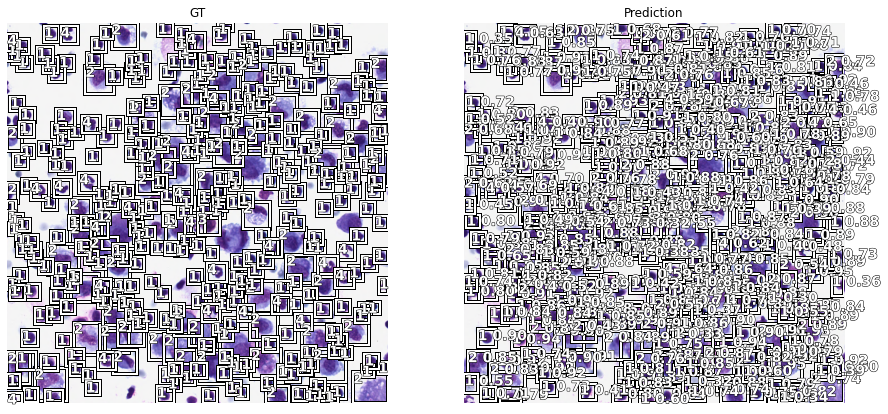

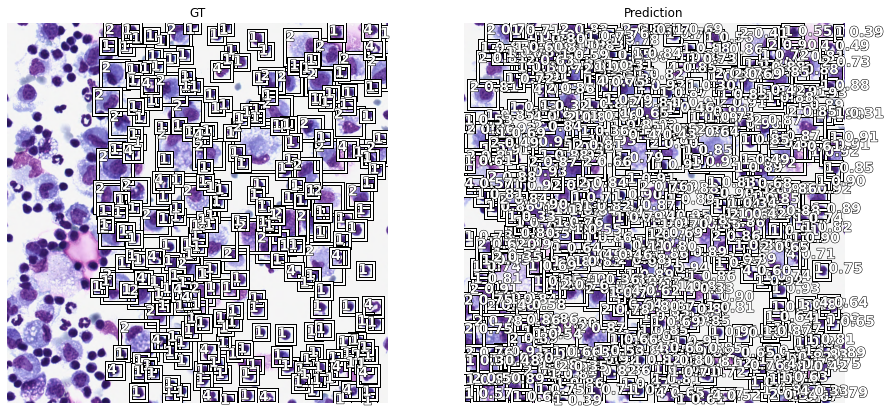

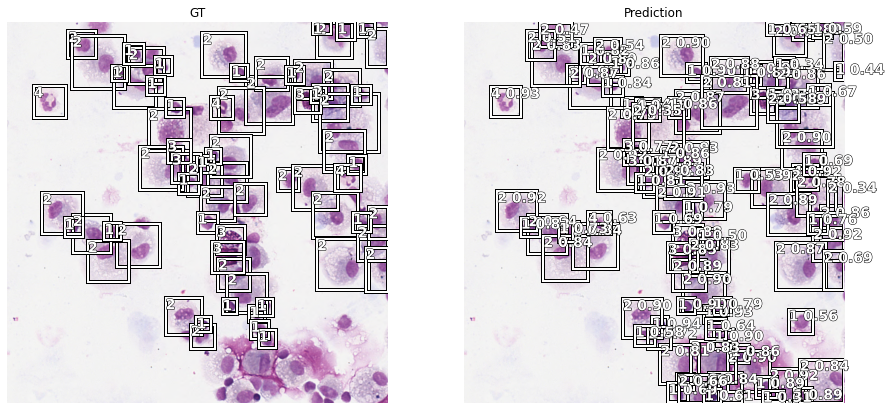

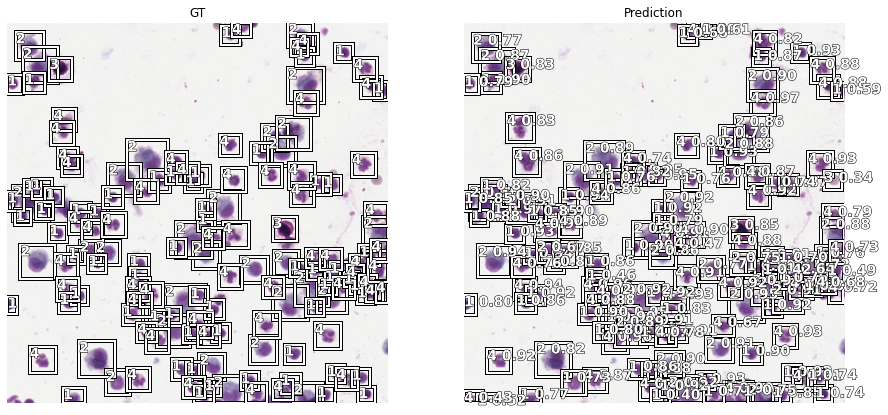

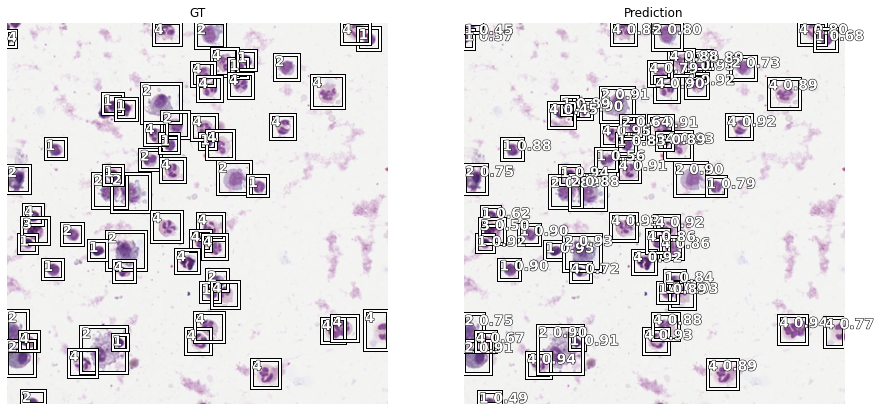

In [34]:
slide_object_result(learn, anchors, detect_thresh=0.3, nms_thresh=0.2)

In [35]:
data.c

6

In [36]:
import pickle

stats = {"anchors": anchors,
         "mean": to_np(data.stats[0]),
         "std": to_np(data.stats[1]),
         "size": size,
         "n_classes": data.c,
         "n_anchors": len(scales),
         "sizes": [64, 32],
         "chs": 128,
         "encoder": "RN-18",
         "n_conv": 2,
         "level": 0,
         "model": get_model(learn.model).state_dict()
        }

torch.save(stats, "{}.p".format(experiment_name))

In [37]:
data.classes 

['background',
 'Eosinophile',
 'Lymohozyten',
 'Makrophagen',
 'Mastzellen',
 'Neutrophile']

In [38]:
learn.fit_one_cycle(10, 1e-4)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.132319,0.298413,0.641891,0.099300,0.199113,0.656623,0.545256,0.727329,0.595327,0.684921,12:50
1,0.129561,0.295697,0.641412,0.096299,0.199398,0.655324,0.555415,0.720226,0.613615,0.662479,12:54
2,0.129881,0.303663,0.672865,0.105768,0.197895,0.761342,0.551972,0.733316,0.635979,0.681714,12:50
3,0.130955,0.293801,0.655311,0.097044,0.196757,0.657363,0.543681,0.729908,0.665386,0.680216,13:03
4,0.130185,0.327722,0.664079,0.120620,0.207102,0.750272,0.551816,0.711501,0.613696,0.693108,13:03
5,0.129609,0.308130,0.637016,0.097420,0.210710,0.671924,0.540945,0.698764,0.604241,0.669206,12:55
6,0.127466,0.295803,0.674531,0.105165,0.190638,0.770926,0.566136,0.731831,0.627725,0.676035,12:44
7,0.126653,0.301396,0.637324,0.098516,0.202880,0.702416,0.541970,0.701646,0.578936,0.661651,13:01
8,0.127154,0.294003,0.657445,0.093966,0.200036,0.775703,0.534618,0.710378,0.605763,0.660762,12:34
9,0.123893,0.289421,0.657567,0.095513,0.193909,0.784528,0.540189,0.719850,0.573383,0.669887,12:47


In [39]:
learn.fit_one_cycle(10, 1e-4)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.123037,0.308835,0.653105,0.100688,0.208146,0.719498,0.539489,0.703100,0.636651,0.666787,12:27
1,0.123326,0.318986,0.649294,0.115974,0.203012,0.743173,0.531002,0.703037,0.591717,0.677543,12:29
2,0.124093,0.299381,0.661572,0.099605,0.199777,0.724490,0.528178,0.701607,0.666897,0.686689,13:07
3,0.123601,0.290128,0.655460,0.097506,0.192622,0.762843,0.533218,0.728043,0.586722,0.666474,12:35
4,0.123776,0.275741,0.656757,0.090119,0.185622,0.733519,0.537292,0.725257,0.605575,0.682141,13:00
5,0.124568,0.314472,0.646670,0.103497,0.210975,0.752363,0.542958,0.703198,0.557497,0.677336,12:53
6,0.122111,0.311054,0.634953,0.101011,0.210043,0.664858,0.541291,0.712676,0.601295,0.654643,12:44
7,0.122034,0.285353,0.640218,0.091775,0.193578,0.690550,0.541165,0.707476,0.584797,0.677102,12:46
8,0.121162,0.290403,0.641727,0.094033,0.196370,0.691761,0.538860,0.698166,0.597820,0.682026,12:31
9,0.120185,0.290325,0.647174,0.097509,0.192816,0.707625,0.543956,0.713870,0.591636,0.678781,12:46


In [40]:
learn.fit_one_cycle(10, 1e-5)

epoch,train_loss,valid_loss,pascal_voc_metric_by_distance,BBloss,focal_loss,AP-Eosinophile,AP-Lymohozyten,AP-Makrophagen,AP-Mastzellen,AP-Neutrophile,time
0,0.120929,0.294019,0.633857,0.096063,0.197957,0.667382,0.545057,0.703754,0.574855,0.678236,12:52
1,0.122227,0.293506,0.634045,0.097289,0.196217,0.627568,0.545630,0.702296,0.615205,0.679525,12:50
2,0.119716,0.297455,0.641008,0.099961,0.197494,0.687217,0.540750,0.703821,0.603209,0.670043,12:49
3,0.119462,0.290577,0.634557,0.094336,0.196241,0.658762,0.549152,0.702155,0.596150,0.666566,12:35


KeyboardInterrupt: 